In [1]:
# Data Manipulation and Preprocessing
import numpy as np
import pandas as pd
import json
import labtools

# Data Visualization
import matplotlib.pyplot as plt
import plotly.graph_objects as go

import warnings
# Suppress the SettingWithCopyWarning
warnings.filterwarnings('ignore')

# Web Interaction and Display
from IPython.display import Image, display, HTML

# Additional JavaScript for toggling code display in Jupyter Notebooks
HTML(
    """
<script src="https://cdnjs.cloudflare.com/ajax/libs/jquery/2.0.3/jquery.min.js "></script>
<script>
code_show=true; 
function code_toggle() {
 if (code_show){
 $('div.jp-CodeCell > div.jp-Cell-inputWrapper').hide();
 } else {
 $('div.jp-CodeCell > div.jp-Cell-inputWrapper').show();
 }
 code_show = !code_show
} 
$( document ).ready(code_toggle);
</script>
<form action="javascript:code_toggle()"><input type="submit"
    value="Click here to toggle on/off the raw code."></form>
"""
)

In [2]:
final_df = pd.read_csv('final_df.csv')

<div style="background-color:#711012; padding: 10px 0;">
    <center><h2 style="color: white; font-weight:bold">SUPPLEMENTARY NOTEBOOK 
        (2021-2024)</h2></center>
</div>

This notebook contains the implementation of the clustering method applied to the abstracts of research publications released between 2021 and 2024.

---

<div style="background-color:#711012; padding: 10px 0;">
    <center><h2 style="color: white; font-weight:bold">TOKEN VECTORIZATION</h2></center>
</div>

For the year 2006 and onwards, our dataset is composed of 1000 samples per year. The purpose of this is to reduce the computational complexity of our analysis.

In [4]:
# Get the 2021-2014 data
window = list(range(2021, 2025))
df_2021 = final_df[final_df.year.isin(window)]
df_2021 = labtools.get_sample(df_2021, window, sample_size=1000)

This is a snippet of a list of consolidated abstracts of two publications submitted between 2021 and 2024.

In [5]:
# Get the abstract of the 2006-2010 dataset
abs_2021 = df_2021.abstract.to_list()
print(abs_2021[:2])

['  Three phases of macroscopic domains have been seen for large but finite\nperiodic dimer models; these are known as the frozen, rough and smooth phases.\nThe transition region between the frozen and rough region has received a lot of\nattention for the last twenty years and recently work has been underway to\nunderstand the rough-smooth transition region in the case of the two-periodic\nAztec diamond. We compute uniform asymptotics for dimer-dimer correlations of\nthe two-periodic Aztec diamond when the dimers lie in the rough-smooth\ntransition region. These asymptotics rely on a formula found in [5] for the\ninverse Kasteleyn matrix, they also apply to a related infinite dimer model.\n', '  We consider the setting in which a strong binary instrument is available for\na binary treatment. The traditional LATE approach assumes the monotonicity\ncondition stating that there are no defiers (or compliers). Since this\ncondition is not always obvious, we investigate the sensitivity and t

We next create a matrix representing certain words on this list as a column and their corresponding frequencies within each abstract as values in the matrix. This matrix allows for quantitative analysis of the abstracts based on the occurrence of specific keywords or terms. 

To determine the optimal values for `min_df` and `max_df`, we created a heatmap that shows the sparsity of the TF-IDF matrix for different combinations of `min_df` and `max_df` values. The sparsity is calculated as the ratio of zero elements in the matrix to the total number of elements.

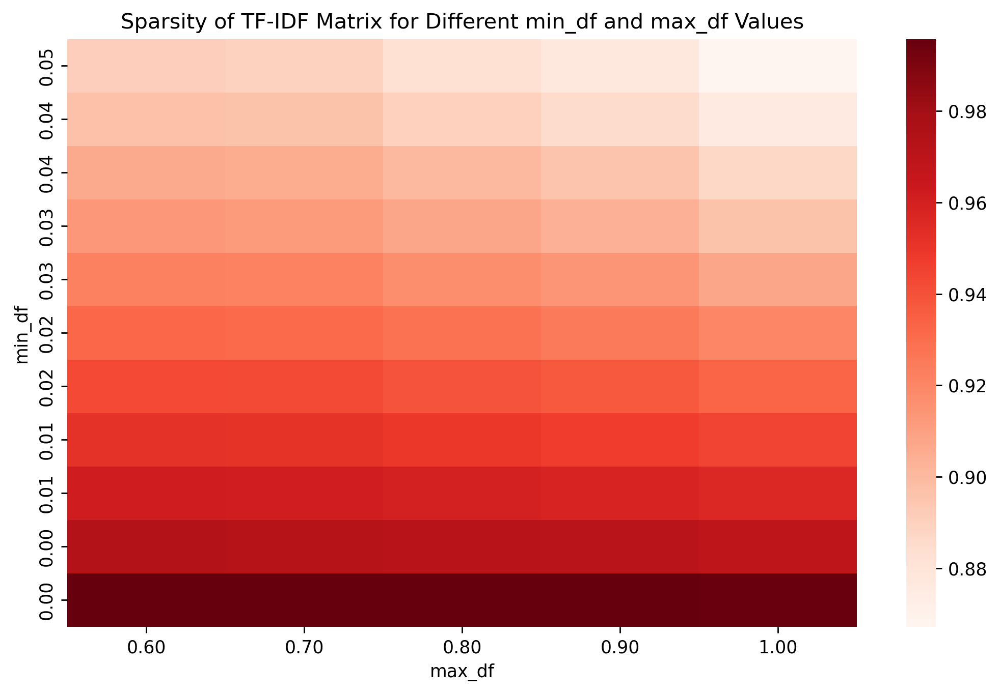

In [6]:
labtools.visualize_sparsity(abs_2021)

<center>
    <h6>
        <b>Figure 1. 
        </b> Sparsity of TF-IDF Matrix for Different <code>min_df</code> and<code>max_df</code> values
    </h6>
</center>

- **Lower right corner (high `min_df`, low `max_df`)**: This region has the lowest sparsity, indicating that most terms are included in the vocabulary due to the lenient filtering.
- **Upper left corner (low `min_df`, high `max_df`)**: This region has the highest sparsity, indicating that many terms have been excluded from the vocabulary due to the aggressive filtering of rare and common terms.
- **Diagonal trend**: As you move from the upper left corner to the lower right corner, the sparsity generally increases. This is because increasing `min_df` and decreasing `max_df` results in more aggressive filtering of the vocabulary.

The heatmap highlights the trade-off between sparsity and vocabulary size. A sparser matrix (higher sparsity) may be more computationally efficient, but it may also exclude important terms. A denser matrix (lower sparsity) includes more terms but may also include noise.

We chose the middle of the heatmap as the optimal region for the values of `min_df` and `max_df`, indicating a balance between including informative terms and excluding noise.

Let's also remove English and context-specific stopwords. Our resulting matrix looks like this:

In [7]:
df_tfidf_21 = labtools.vectorize_abstract(abs_2021, min_df=0.03, max_df=0.80)
df_tfidf_21.head(3)

,ability,accuracy,accurate,achieve,achieved,achieves,adaptive,addition,additional,additionally,...,unknown,user,users,values,vision,visual,wide,widely,works,years
0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.33276
1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.00000
2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.105491,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.00000


<center>
    <h6>
        <b>Table 1. 
        </b>TF-IDF Matrix
    </h6>
</center>

<div style="background-color:#711012; padding: 10px 0;">
    <center><h2 style="color: white; font-weight:bold">DIMENSIONALITY REDUCTION</h2></center>
</div>

Next, we reduce the complexity of the dataset by decreasing the number of its dimensions. We first determine the number of singular vectors that would give us at least 90% of the variance explained using the `TruncatedSVD` method.

Number of components for at least 90% variance explained: 279


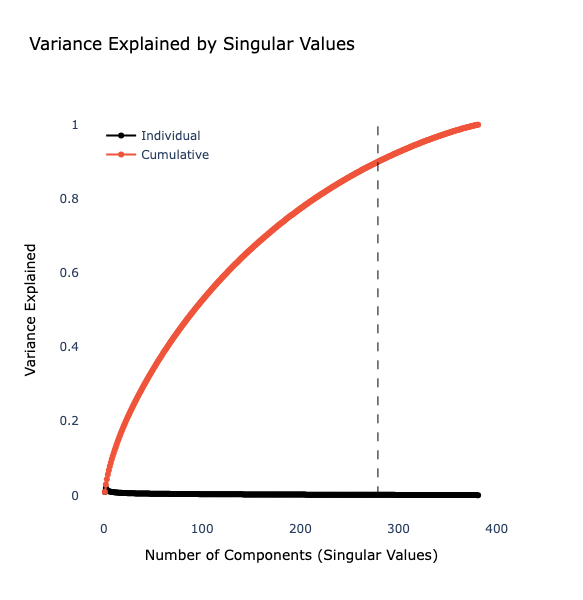

279

In [8]:
labtools.get_n_components(df_tfidf_21, show_viz=True)

<center>
    <h6>
        <b>Figure 2. 
        </b> Individual and Cumulative Variance Explained of the SV Components
    </h6>
</center>


We then proceed to reducing the number of dimensions of our dataset based on the initial check.

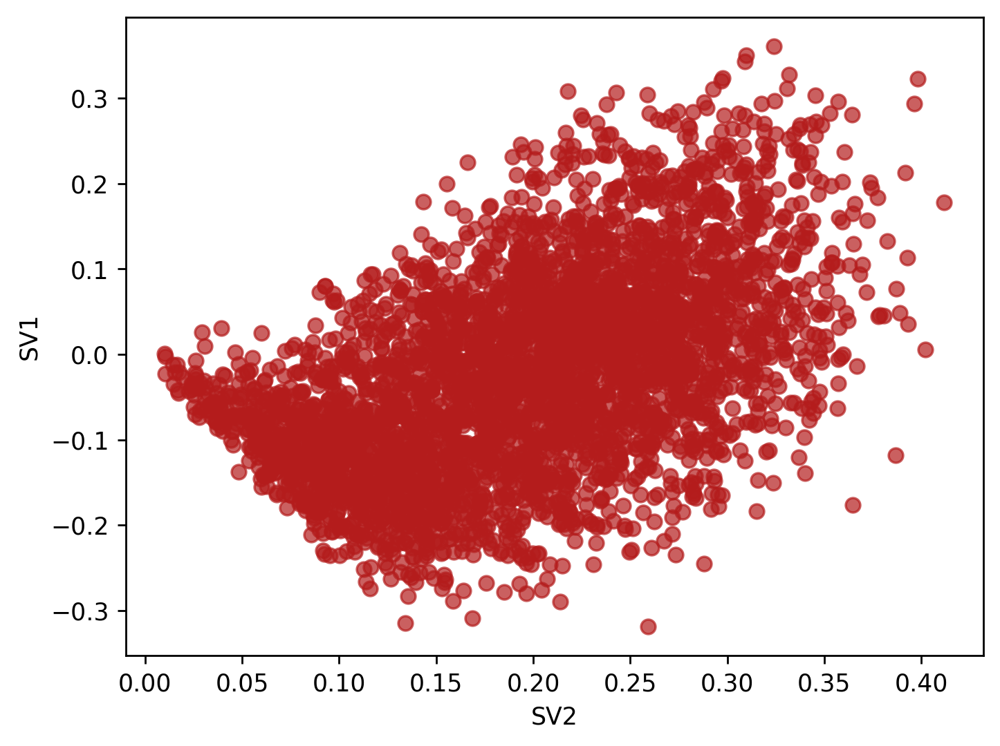

In [9]:
reduced_21 = (labtools.reduce_dimensions(labtools
                                         .get_n_components(df_tfidf_21,
                                                           show_viz=False),
                                         df_tfidf_21))
plt.figure(dpi=250)
plt.scatter(reduced_21[:, 0], reduced_21[:, 1], alpha=0.7, color='#b41c1c')
plt.xlabel('SV2')
plt.ylabel('SV1');

<center>
    <h6>
        <b>Figure 3. 
        </b> The TF-IDF as projected to the first two singular vectors
    </h6>
</center>


<div style="background-color:#711012; padding: 10px 0;">
    <center><h2 style="color: white; font-weight:bold">CLUSTERING</h2></center>
</div>

Optimal number of clusters: 2
Threshold distance: 7.168220


7.168220365235813

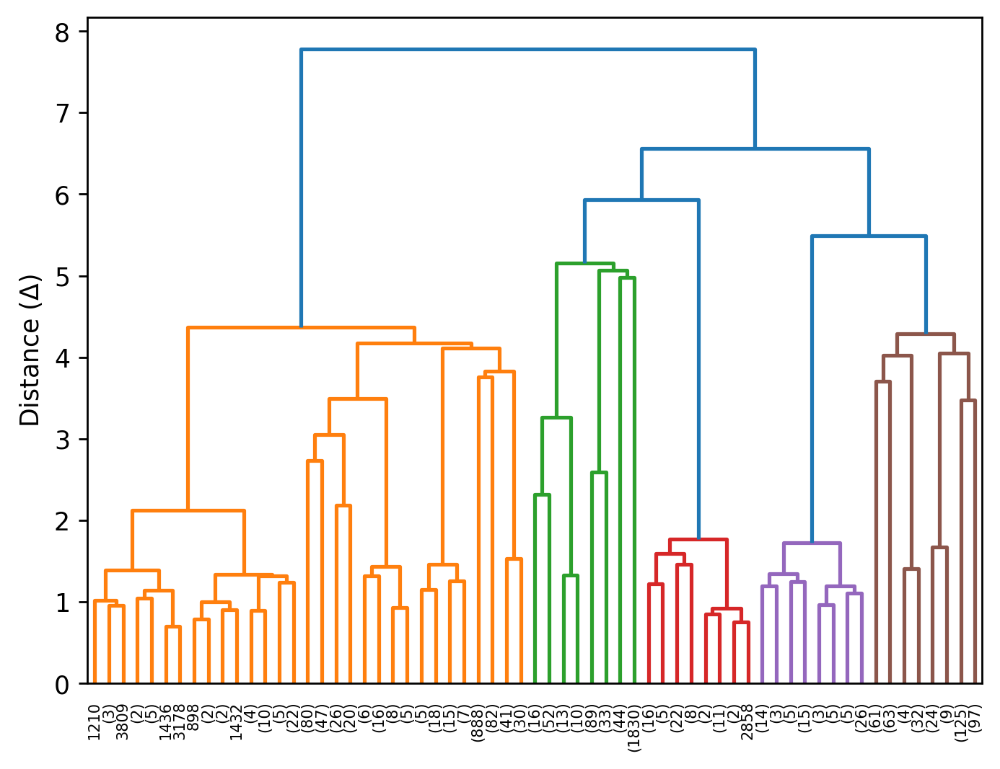

In [10]:
labtools.hierarchical_clustering(reduced_21)

<center>
    <h6>
        <b>Figure 4. 
        </b> Ward's Clustering Dendrogram Results
    </h6>
</center>


From the dendrogram, we see that the optimal number of clusters is two. However, it would be interesting to investigate the sub-clusters that were formed under each main cluster because we can see that one main cluster has more points, so it is possible that we can further find subgroups under it. Let's check these both.

<div style="background-color: #cbc6c6; padding: 10px 0;">
    <center><h4 style="color: #242424;font-weight:bold">EDA on Initial Clusters</h4></center>
</div>

Let's first check the two main clusters. This is what it looks when projected on the first two singular vectors:

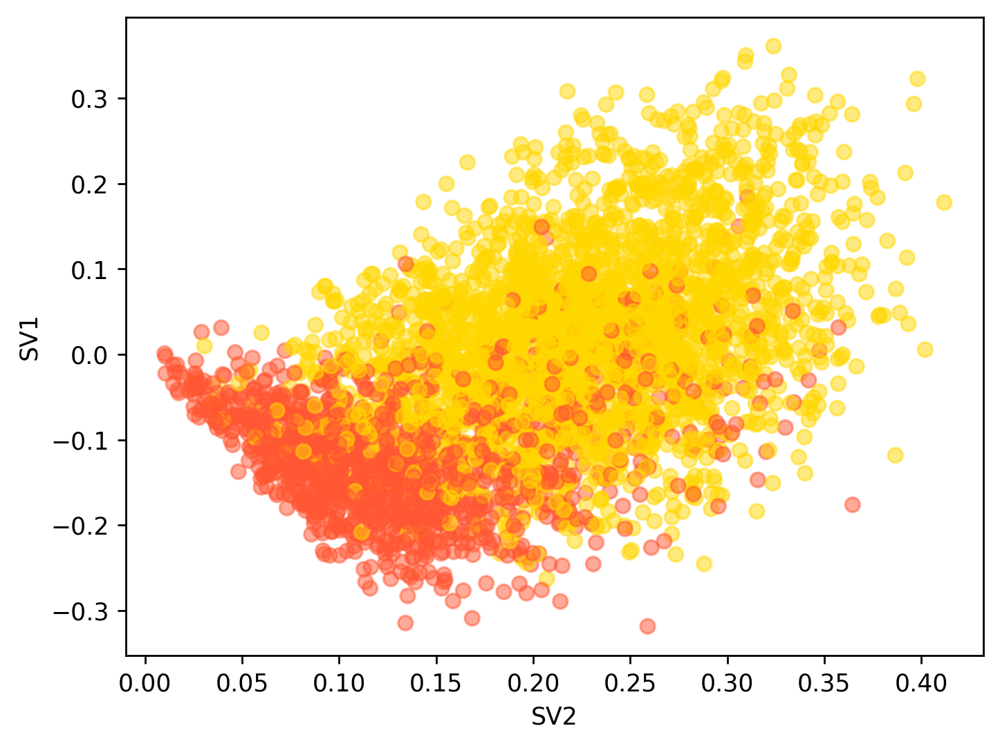

In [11]:
labtools.cluster_predict(reduced_21, df_2021, show_viz=True)

<center>
    <h6>
        <b>Figure 5. 
        </b> Clustering Results as Projected on the First Two Singular Vectors
    </h6>
</center>

Let's visualize the abstracts of the publications belonging to each main cluster using a word cloud to have an idea on what the cluster is all about.

In [12]:
clustered_df = labtools.cluster_predict(reduced_21, df_2021, show_viz=False,
                               get_updated_df=True)

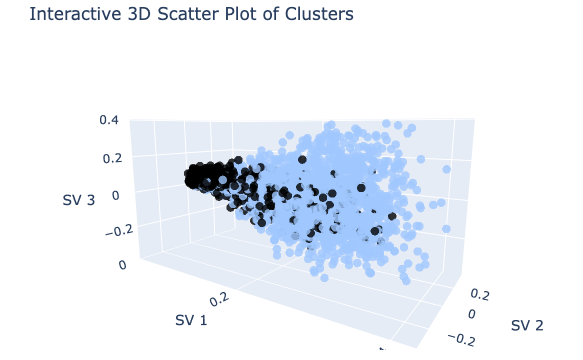

In [13]:
import plotly.graph_objects as go

# Assuming you have already performed dimensionality reduction
# and have reduced data stored in reduced_06 DataFrame

# Create a 3D scatter plot
fig = go.Figure(data=[go.Scatter3d(
    x=reduced_21[:, 0],
    y=reduced_21[:, 1],
    z=reduced_21[:, 2],
    mode='markers',
    marker=dict(
        size=5,
        color=clustered_df['cluster'],  # Color points based on cluster
        colorscale='blackbody',  # Choose a color scale
        opacity=0.8
    ),
    text=clustered_df['cluster'].astype(str)  # Add cluster labels as text
)])

# Set axis labels
fig.update_layout(scene=dict(
    xaxis_title='SV 1',
    yaxis_title='SV 2',
    zaxis_title='SV 3',
    aspectratio=dict(x=2, y=1, z=1)  # Adjust the aspect ratio as needed
))

# Adjust the layout to fill the entire space while keeping the controls visible
fig.update_layout(
    autosize=True,  # Enable autosizing to keep controls visible
    margin=dict(l=10, r=10, t=40, b=10),  # Adjust margin values for control visibility
)

# Add title to the plot
fig.update_layout(title='Interactive 3D Scatter Plot of Clusters')

# Show the plot
fig.show()


#### **Initial Cluster 1: 2021-2024**

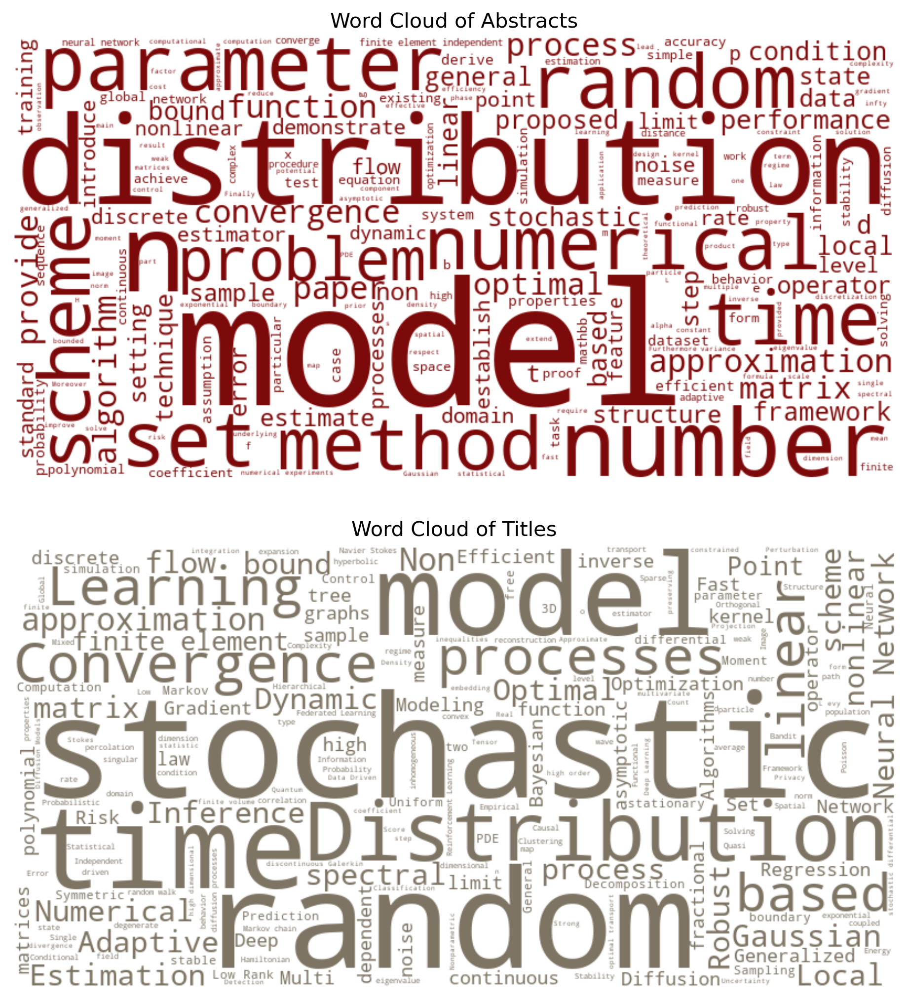

In [14]:
labtools.generate_wordclouds(clustered_df, cluster_number=1)

<center>
    <h6>
        <b>Figure 6. 
        </b> Word Cloud of Initial Cluster 1 (2021-2024)
    </h6>
</center>

#### **Initial Cluster 2: 2021-2024**

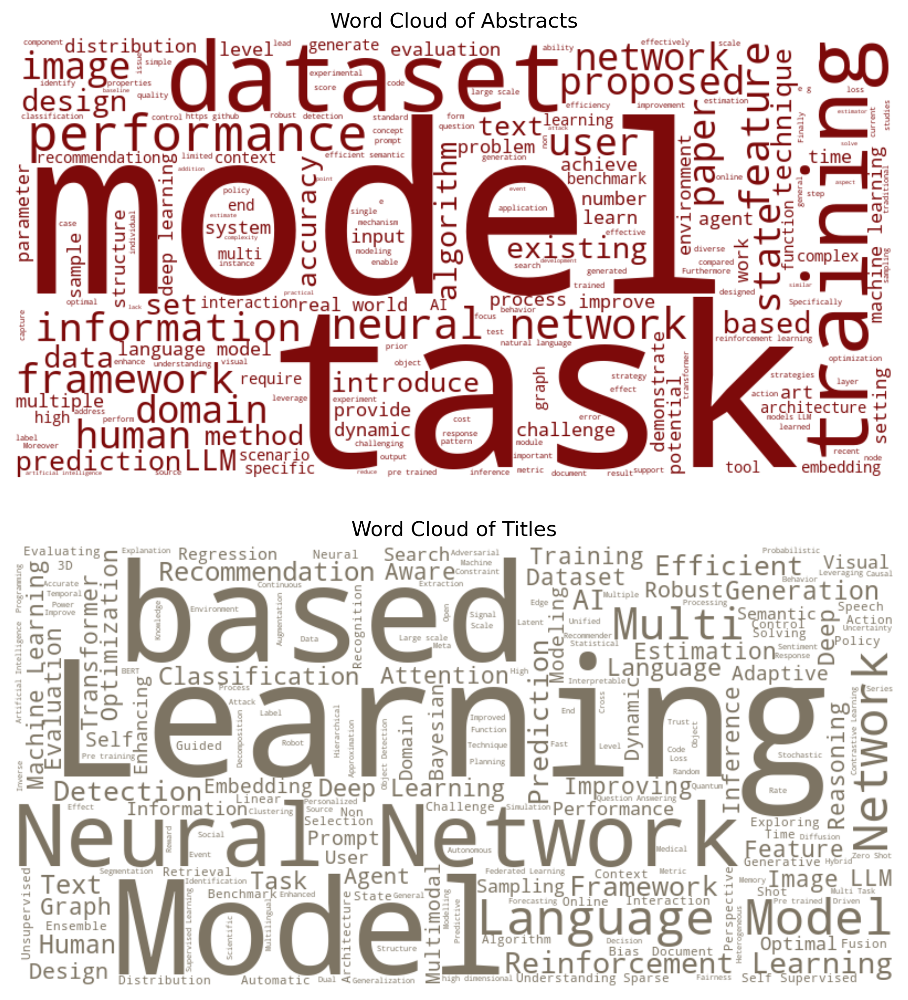

In [15]:
labtools.generate_wordclouds(clustered_df, cluster_number=2)

<center>
    <h6>
        <b>Figure 7. 
        </b> Word Cloud of Initial Cluster 2 (2021-2024)
    </h6>
</center>

**How imbalanced are our main clusters between 2021 and 2024?**

As we can see, Cluster 2 has significantly more points than Cluster 1. Because of this, it could be worth investigating its sub-clusters.

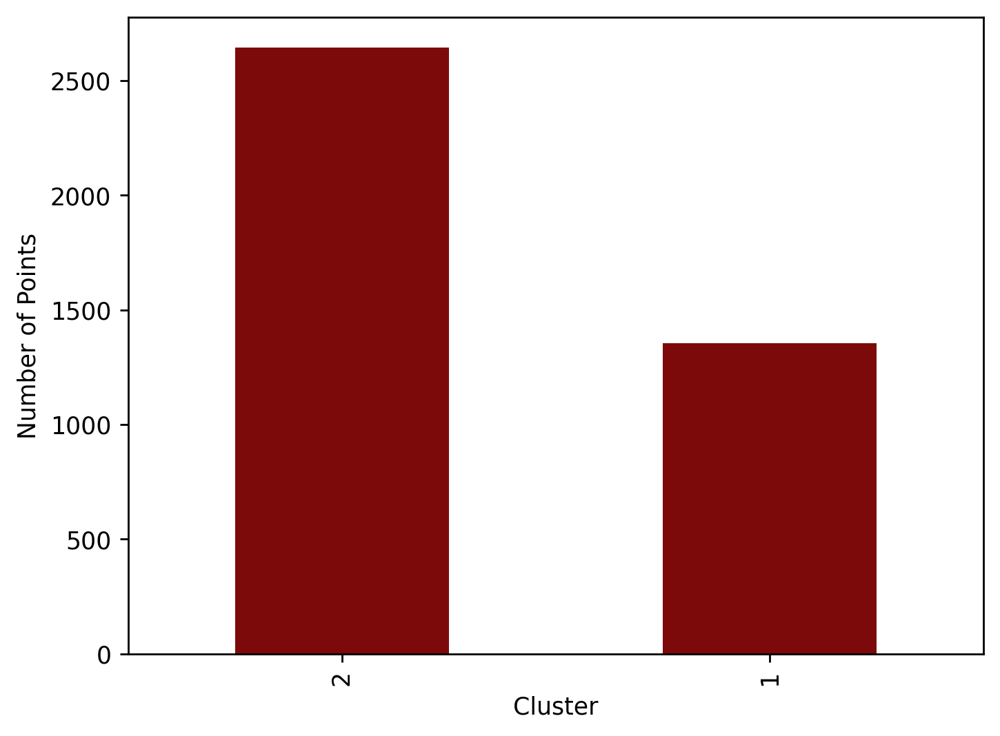

In [16]:
plt.figure(dpi=250)
clustered_df.cluster.value_counts().plot(kind='bar', color='#7d0a0a',
                                         xlabel='Cluster',
                                         ylabel='Number of Points');

<center>
    <h6>
        <b>Figure 8. 
        </b> Visualizing the Distribution of Points to the Initial Clusters
    </h6>
</center>

To do this, we refer back to our dendrogram and change our threshold so that we would capture the subclusters of the large main cluster. Through eyeballing it, a threshold of 5.3 would suffice. The resulting distribution looks like this:

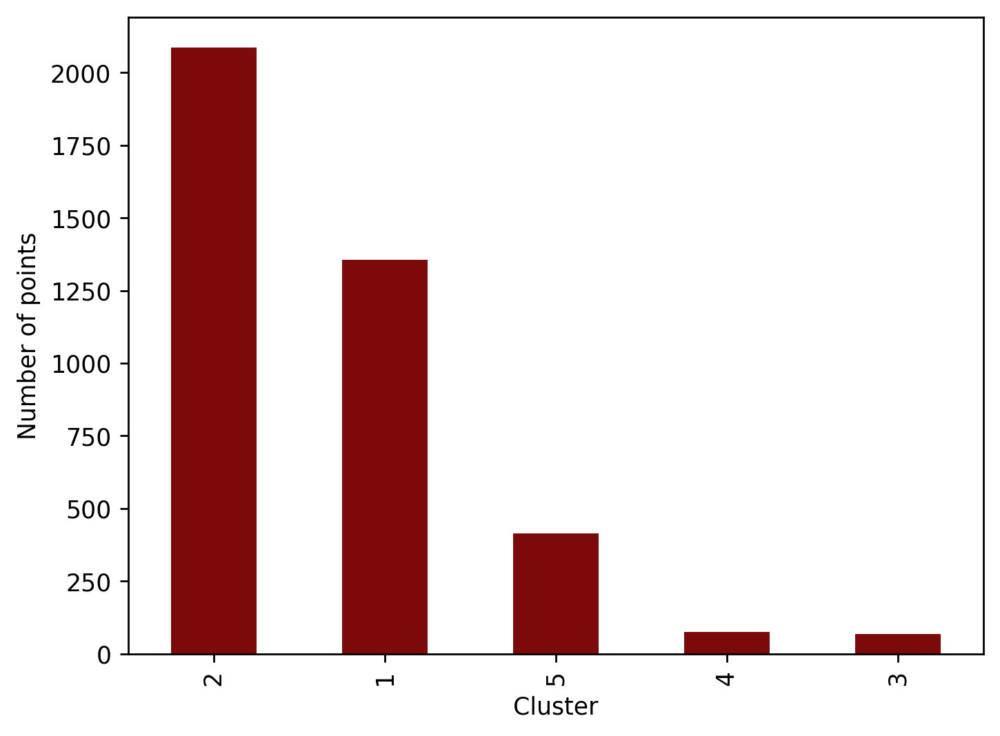

In [18]:
clustered_df = labtools.cluster_predict(reduced_21, df_2021, show_viz=False, 
                               get_updated_df=True, thres=5.3)

plt.figure(dpi=250)
clustered_df.cluster.value_counts().plot(kind='bar', color='#7d0a0a', 
                                         xlabel='Cluster',
                                         ylabel='Number of points');

<center>
    <h6>
        <b>Figure 9. 
        </b> Visualizing the Distribution of Points after Re-clustering
    </h6>
</center>

Although certain clusters still dominate the others with respect to the number of points, the general distribution of the points improved. Let's see what words compose each of these clusters.

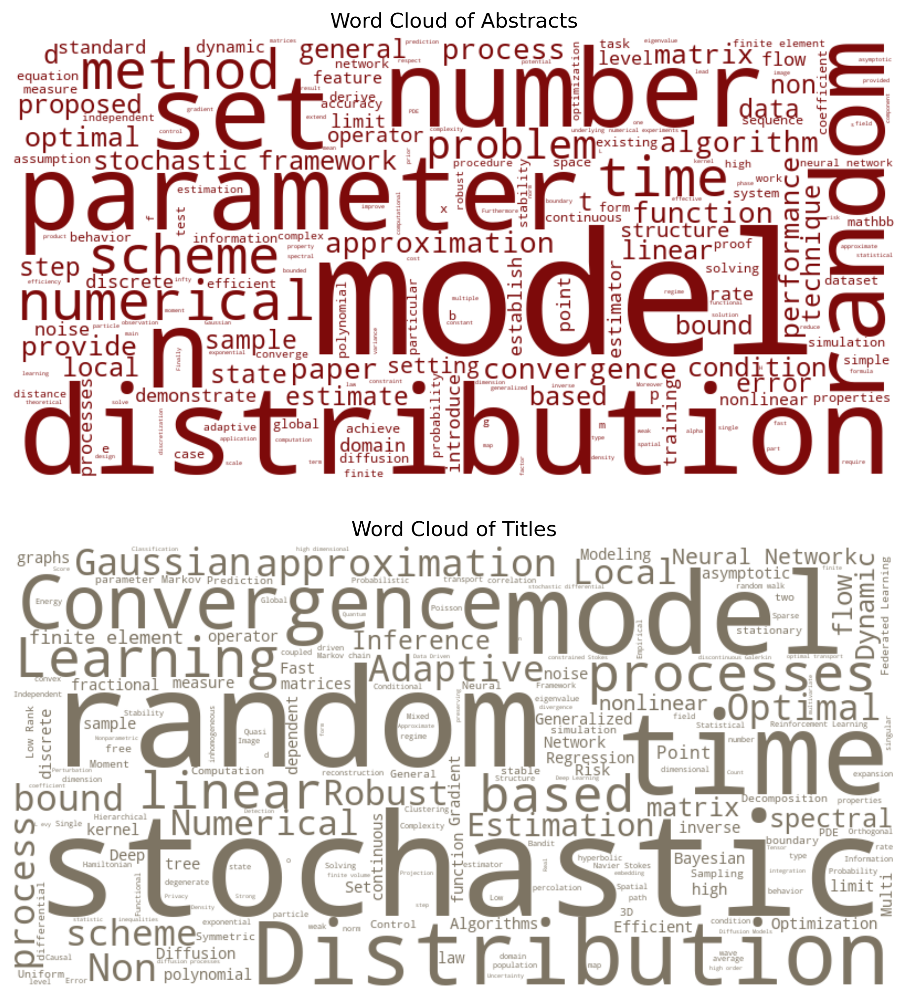

In [20]:
# Cluster 1: 2021-2024
labtools.generate_wordclouds(clustered_df, cluster_number=1)

<center>
    <h6>
        <b>Figure 10. 
        </b> Word Cloud of Final Cluster 1 (2021-2024)
    </h6>
</center>

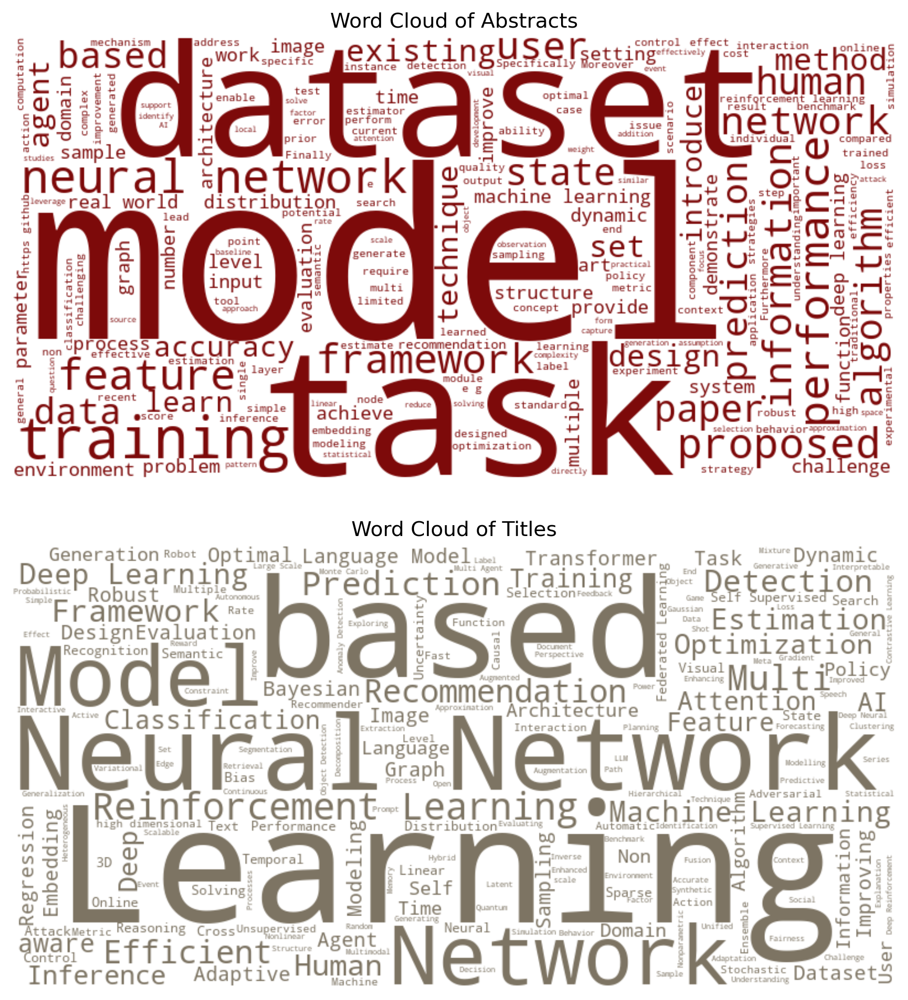

In [22]:
# Cluster 2: 2021-2024
labtools.generate_wordclouds(clustered_df, cluster_number=2)

<center>
    <h6>
        <b>Figure 11. 
        </b> Word Cloud of Final Cluster 2 (2021-2024)
    </h6>
</center>

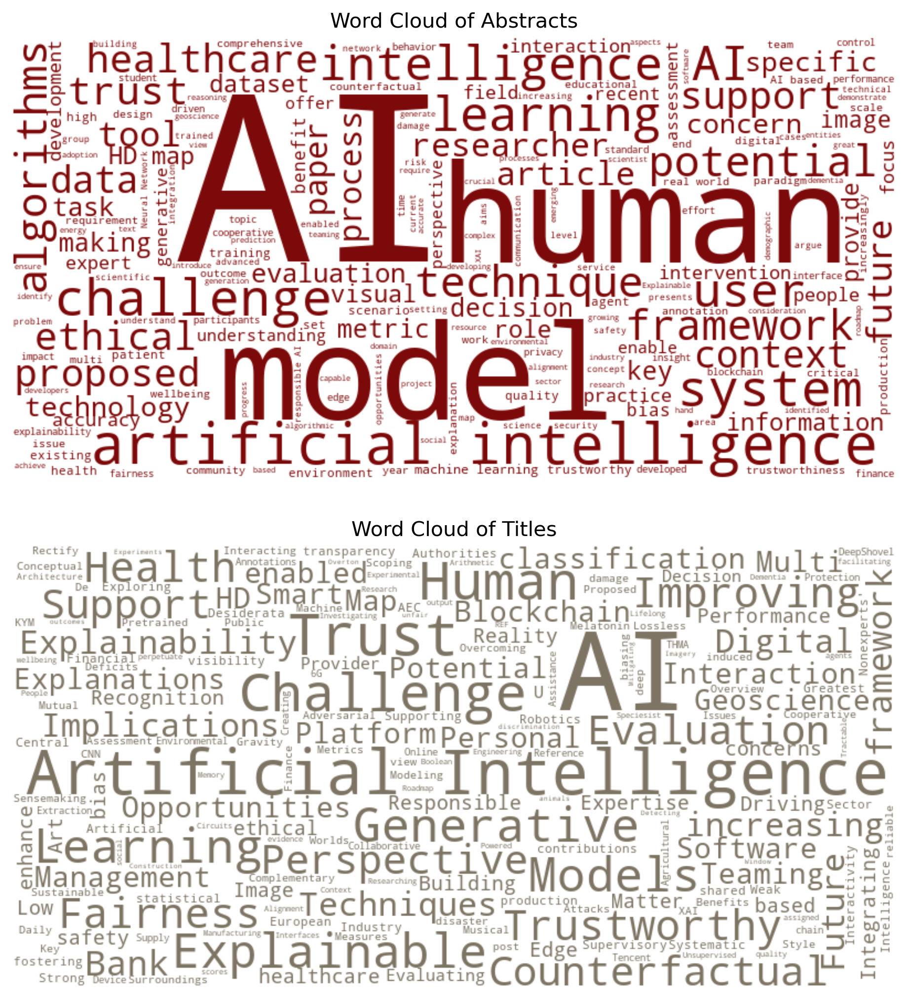

In [23]:
# Cluster 3: 2021-2024
labtools.generate_wordclouds(clustered_df, cluster_number=3)

<center>
    <h6>
        <b>Figure 12. 
        </b> Word Cloud of Final Cluster 3 (2021-2024)
    </h6>
</center>

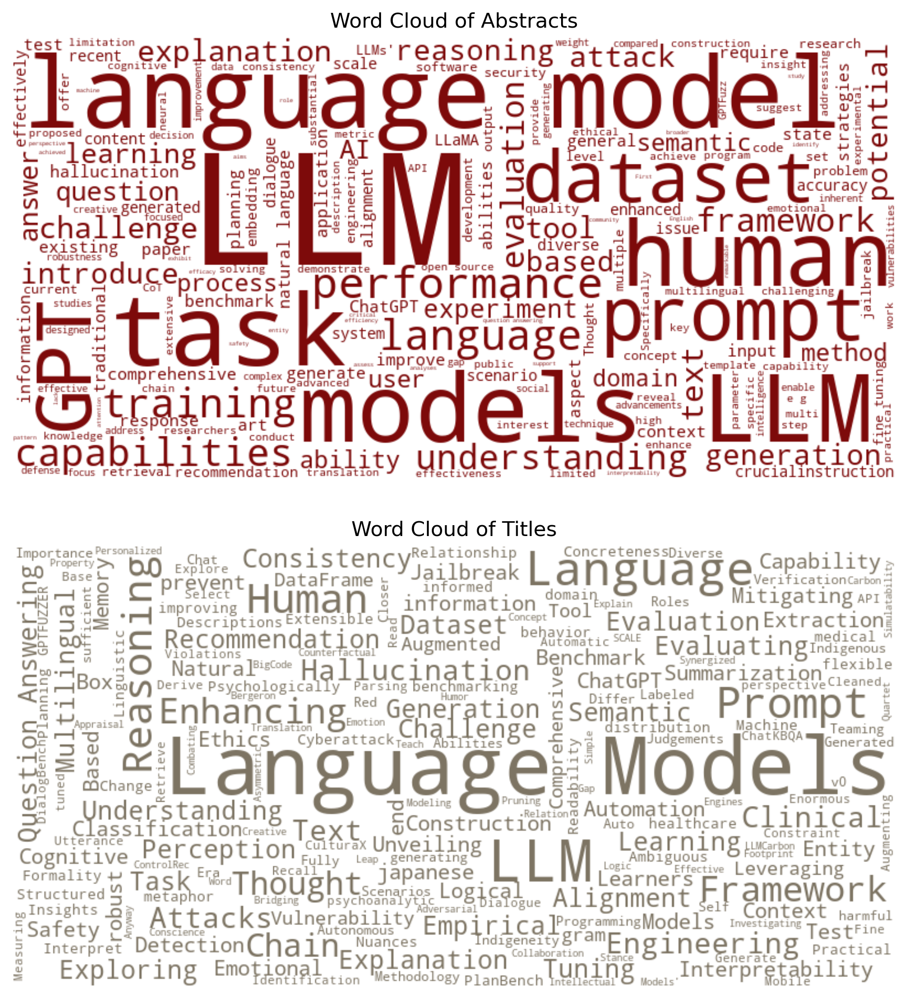

In [24]:
# Cluster 4: 2021-2024
labtools.generate_wordclouds(clustered_df, cluster_number=4)

<center>
    <h6>
        <b>Figure 13. 
        </b> Word Cloud of Final Cluster 4 (2021-2024)
    </h6>
</center>

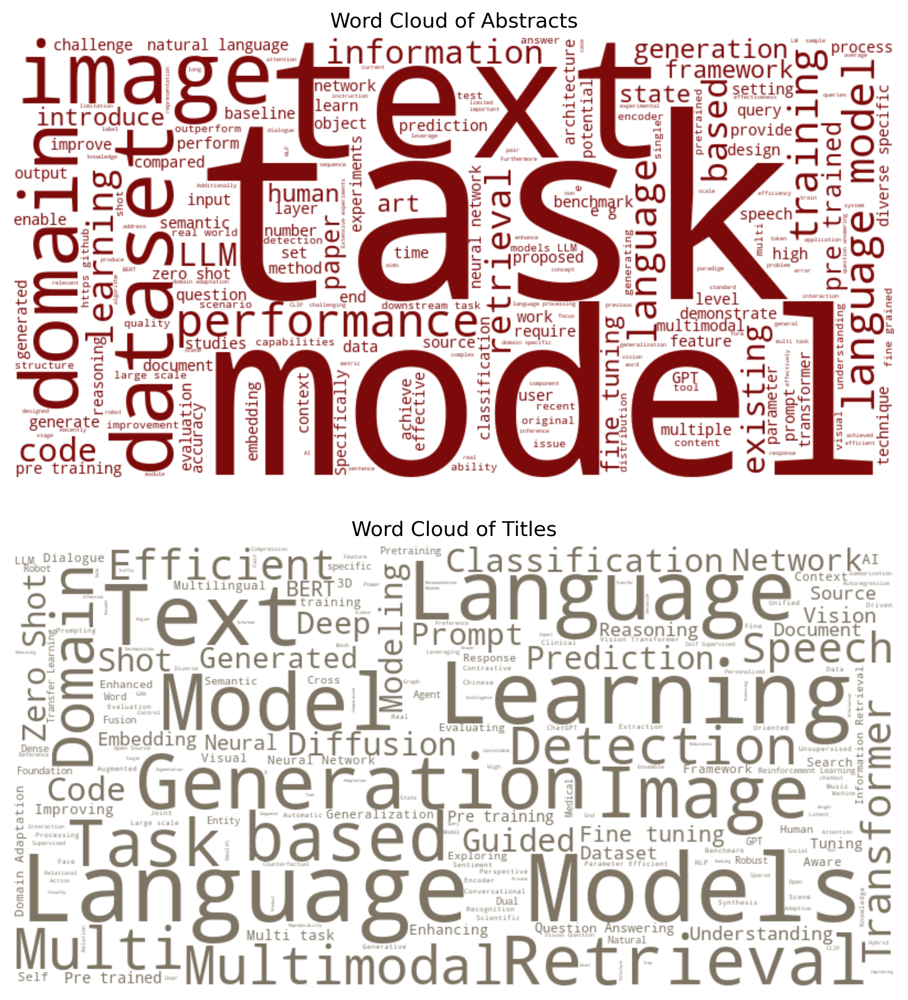

In [25]:
# Cluster 5: 2021-2024
labtools.generate_wordclouds(clustered_df, cluster_number=5)

<center>
    <h6>
        <b>Figure 14. 
        </b> Word Cloud of Final Cluster 5 (2021-2024)
    </h6>
</center>

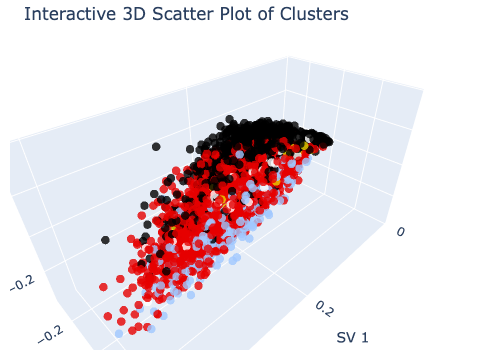

In [28]:
# Create a 3D scatter plot
fig = go.Figure(data=[go.Scatter3d(
    x=reduced_21[:, 0],
    y=reduced_21[:, 1],
    z=reduced_21[:, 2],
    mode='markers',
    marker=dict(
        size=5,
        color=clustered_df['cluster'],  # Color points based on cluster
        colorscale='blackbody',  # Choose a color scale
        opacity=0.8
    ),
    text=clustered_df['cluster'].astype(str)  # Add cluster labels as text
)])

# Set axis labels
fig.update_layout(scene=dict(
    xaxis_title='SV 1',
    yaxis_title='SV 2',
    zaxis_title='SV 3',
    aspectratio=dict(x=2, y=1, z=1)  # Adjust the aspect ratio as needed
))

# Adjust the layout to fill the entire space while keeping the controls visible
fig.update_layout(
    autosize=True,  # Enable autosizing to keep controls visible
    margin=dict(l=10, r=10, t=40, b=10),  # Adjust margin values for control visibility
)

# Add title to the plot
fig.update_layout(title='Interactive 3D Scatter Plot of Clusters')

# Show the plot
fig.show()


<div style="background-color:#711012; padding: 10px 0;">
    <center><h2 style="color: white; font-weight:bold">CLUSTER INTERPRETATION</h2></center>
</div>

#### **Initial Cluster 1: Stochastic Processes and Model Convergence**
- **Insights**: This cluster seemed to have retained some similarities with Cluster 1 of 2016-2020, which was focused on stochastic models and algorithmic optimization. However, there are noticeable differences in the keywords. In the new cluster, the decrease in the size of the algorithm keyword in the Abstract suggests a potential shift in focus away from algorithmic aspects. In the context of publication titles, the new cluster seems to lean more towards stochastic processes and their convergence.
- **Abstract keywords**: distribution, model, parameter, numerical, method, scheme
- **Title keywords**: stochastic, time, random, distribution, model, learning, convergence

#### **Initial Cluster 2: Learning Models and Language Embeddings**
- **Insights**: Similarly, the initial cluster 2 for this period has noticeable similarities with that of 2016-2020. However, this cluster reflects more the focus on learning models, language embeddings, and tasks related to human interaction and language understanding. It captures the shift towards exploring large language models and their applications in various tasks, indicating a broader exploration of artificial intelligence and language processing techniques. As we saw, this merited further sub-clustering because the distribution of the data points is more concentrated on this cluster than the other.
- **Abstract keywords**: task, model, training, dataset
  - **Increase in size (compared to 2016-2020)**: task, training
  - **Decrease in size (compared to 2016-2020)**: neural network, dataset, image, feature
  - **Noticeable new words**: LLM, human, embedding
- **Title keywords**: learning, neural network, model, 
  - **Increase in size (compared to 2016-2020)**: language model
  - **Decrease in size (compared to 2016-2020)**: neural network, reinforcement learning, deep learning
  - **Noticeable new words**: AI, language model, embedding, prompt

#### **Final Cluster 1: Stochastic Processes and Model Convergence**
- This cluster essentially captures the theme of the initial Cluster 1
- **Abstract keywords**: model, distribution, parameter, random
- **Title keywords**: stochastic, random, time, convergence

#### **Final Cluster 2: General Machine Learning Models**
- While this shares similarity to the previous initial cluster 2, this cluster is now more focused on the general space of machine learning
- **Abstract keywords**: model, task, dataset, training
- **Title keywords**: neural network, learning, reinforcement learning, machine learning

#### **Final Cluster 3: Artificial Intelligence: Healthcare applications, Explainability, and Ethical Frameworks**
- **Abstract keywords**: AI, human, healthcare, ethical, framework, 
- **Title keywords**: AI, trust, human, improving, explainable, counterfactual, fairness, health, evaluation, improving

#### **Final Cluster 4: Large Language Models**
- **Abstract keywords**: LLM, prompt, GPT, task, 
- **Title keywords**: language models, reasoning

#### **Final Cluster 5: Multimodal Language and Understanding**
- **Abstract keywords**: task, model, text, image, domain, language
- **Title keywords**: language, models, image, multimodal, retrieval, text, transformer
- While this final cluster appears similar to the previous cluster (LLMs), there are subtle differences. Cluster 4 emphasizes reasoning tasks in both abstract and title keywords, while Cluster 5 focuses on understanding multimodal data, including text and images, for tasks such as retrieval. Cluster 4 also mentioned specific language models like GPT and focuses on tasks related to these models. Meanwhile, Cluster 5 mentions language models in general and focuses on their application in understanding multimodal data.